# 教程 3：分析和可视化方法

> **阅读时间**：约 40-50 分钟
> **难度**：初级
> **先决条件**：[教程 1](./01_build_cann_model.ipynb) 和 [教程 2](./02_task_and_simulation.ipynb)

本教程介绍了 CANNs 分析器模块中的可视化和分析方法。

---

## 目录

1. [分析器模块和PlotConfigs概述](#1-analyzer-module-and-plotconfigs-overview)
2. [1D分析方法](#2-1d-analysis-methods)
3. [不同任务的能量景观](#3-energy-landscapes-for-different-tasks)
4. [2D分析方法](#4-2d-analysis-methods)
5. [后续步骤](#5-next-steps)

---

## 1. Analyzer 模块和 PlotConfigs 概览

`canns.analyzer.plotting` 模块为分析模拟结果提供可视化方法。所有绘图函数都使用 **PlotConfigs** 系统进行统一配置管理。

### 1.1 可用的绘图方法

**1D 模型分析**：
- `energy_landscape_1d_static` - 静态能量景观
- `energy_landscape_1d_animation` - 动画能量景观
- `raster_plot` - 脉冲光栅图
- `average_firing_rate_plot` - 随时间的平均放电率
- `tuning_curve` - 神经调谐曲线

**2D 模型分析**：
- `energy_landscape_2d_static` - 2D 静态能量景观
- `energy_landscape_2d_animation` - 2D 动画能量景观

### 1.2 PlotConfigs 系统

**PlotConfigs** 提供特定方法的配置构建器。每个绘图方法都有相应的配置构建器：

```python
from canns.analyzer.plotting import (
    PlotConfigs,
    energy_landscape_1d_static,
    energy_landscape_1d_animation,
    raster_plot,
    average_firing_rate_plot,
    tuning_curve,
)

# 为每个方法创建配置
config_static = PlotConfigs.energy_landscape_1d_static(
    figsize=(10, 6),
    title='能量景观',
    show=True,        # 显示图表（默认）
    save_path=None    # 不保存到文件（默认）
)

# 将配置与绘图函数结合使用
energy_landscape_1d_static(
    data_sets={'r': (model.x, r_history)},
    config=config_static
)
```

> **注意**：这是一个概念示例。实际用法将在下面的第2部分中使用真实数据进行演示。


**主要优势**:
- **统一界面**: 所有绘图方法遵循相同的模式
- **配置重用**: 一次创建，多次使用
- **清晰的默认值**: `show=True, save_path=None` 用于交互式可视化

> **注意**: 默认情况下，图表会被显示（`show=True`）且不会被保存（`save_path=None`）。设置 `save_path='filename.png'` 来保存图表。

---

## 2. 一维分析方法

让我们使用 SmoothTracking1D 任务演示所有一维分析方法。

### 2.1 准备

In [25]:
import brainstate
from canns.models.basic import CANN1D
from canns.task.tracking import SmoothTracking1D
from canns.analyzer.plotting import (
    PlotConfigs,
    energy_landscape_1d_static,
    energy_landscape_1d_animation,
    raster_plot,
    average_firing_rate_plot,
    tuning_curve,
)

# 设置环境
brainstate.environ.set(dt=0.1)

# 创建模型
model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)
model.init_state()

# 创建平滑跟踪任务
# 刺激从 -2.0 移动到 2.0，然后移动到 -1.0
task = SmoothTracking1D(
    cann_instance=model,
    Iext=[-4.0, 4.0, -2.0, 2.0],      # 关键点位置
    duration=[20.0, 30.0, 20.0], # 每个段的持续时间
    time_step=brainstate.environ.get_dt(),
)

# 获取任务数据
task.get_data()

# 定义模拟步骤
def run_step(t, inp):
    model.update(inp)
    return model.u.value, model.r.value, model.inp.value

# 运行模拟
u_history, r_history, input_history = brainstate.transform.for_loop(
    run_step,
    task.run_steps,
    task.data,
    pbar=brainstate.transform.ProgressBar(10)
)

<SmoothTracking1D> Generating Task data: 0it [00:00, ?it/s]

<SmoothTracking1D> Generating Task data: 700it [00:00, 7853.26it/s]


  0%|          | 0/700 [00:00<?, ?it/s]

### 2.2 能量景观（静态）

`energy_landscape_1d_static` 绘制随时间和神经元位置变化的放电率：

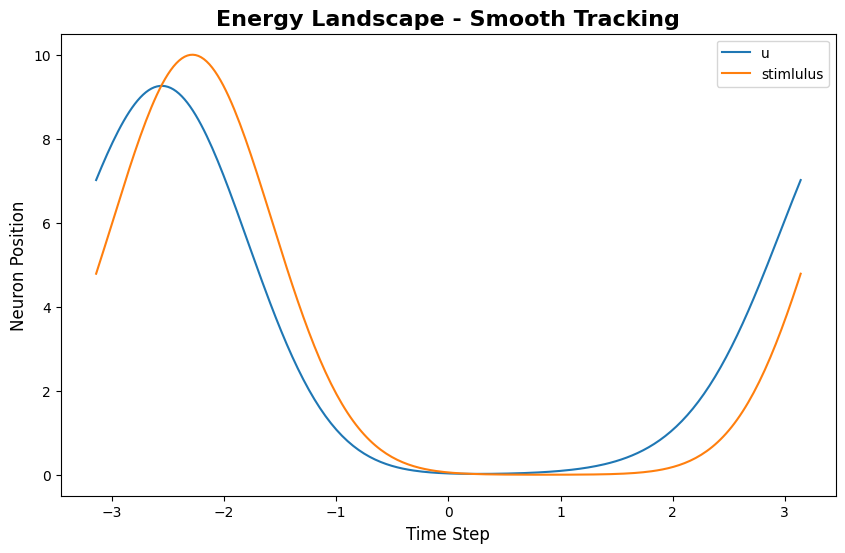

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Energy Landscape - Smooth Tracking'}, xlabel='Time Step', ylabel='Neuron Position'>)

In [26]:
index = 200 # 要可视化的时间步# 配置静态能量景观config_static = PlotConfigs.energy_landscape_1d_static(    figsize=(10, 6),    title='Energy Landscape - Smooth Tracking',    xlabel='Neuron Position',    ylabel='Neuron Position',    show=True,    save_path=None)# 绘制静态能量景观energy_landscape_1d_static(    data_sets={'u': (model.x, u_history[index]), 'stimlulus': (model.x, input_history[index])},    config=config_static)

这显示了碰撞轨迹随时间的变化：x轴为时间，y轴为特征空间位置，颜色强度代表放电速率。

### 2.3 能量景观（动画）

`energy_landscape_1d_animation` 生成动态动画，展示碰撞的演化过程：

In [27]:
# 配置动画config_anim = PlotConfigs.energy_landscape_1d_animation(    time_steps_per_second=100,  # 100个时间步 = 1秒实时时间    fps=20,                      # 每秒20帧    title='Energy Landscape Animation',    xlabel='Firing Rate',    ylabel='Firing Rate',    repeat=True,    show=True,    save_path=None  # 设置为 'animation.gif' 可保存动画)# 生成动画energy_landscape_1d_animation(    data_sets={'u': (model.x, u_history), 'stimlulus': (model.x, input_history)},    config=config_anim)

该动画展示了每个时间步的群体放电率分布，可视化凸起如何在特征空间中移动。

**动画参数**:
- `time_steps_per_second`: 每实时秒的模拟时间步数
- `fps`: 动画的每秒帧数
- `repeat`: 是否循环播放动画

### 2.4 光栅图

`raster_plot` 显示神经元的放电时间：

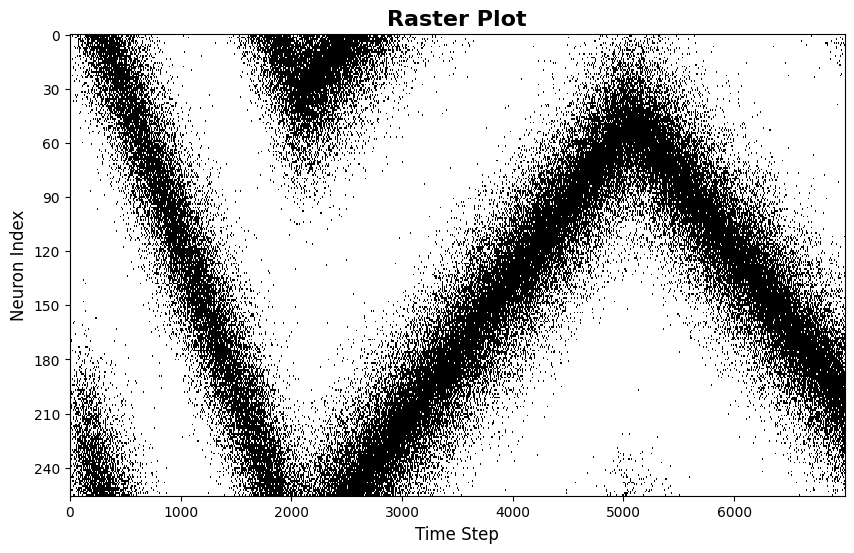

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Raster Plot'}, xlabel='Time Step', ylabel='Neuron Index'>)

In [28]:
from canns.analyzer.utils import firing_rate_to_spike_train# 配置光栅图config_raster = PlotConfigs.raster_plot(    figsize=(10, 6),    title='Raster Plot',    xlabel='Neuron Index',    ylabel='Neuron Index',    show=True,    save_path=None)# 使用 u 生成脉冲序列，因为它具有更高的值spike_train = firing_rate_to_spike_train(u_history, dt_spike=0.01, dt_rate=brainstate.environ.get_dt())# 绘制光栅图raster_plot(    spike_train=spike_train,    config=config_raster)

每个点代表一个神经元在特定时间的放电。该模式揭示了凸起的空间结构和时间演变。

### 2.5 平均放电率图

`average_firing_rate_plot` 显示了种群平均放电率随时间的变化：

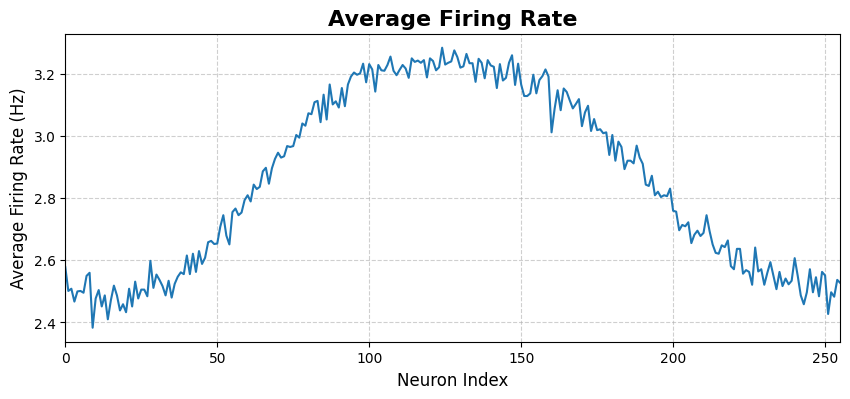

(<Figure size 1000x400 with 1 Axes>,
 <Axes: title={'center': 'Average Firing Rate'}, xlabel='Neuron Index', ylabel='Average Firing Rate (Hz)'>)

In [29]:
# 配置平均放电率图config_avg = PlotConfigs.average_firing_rate_plot(    figsize=(10, 4),    title='Average Firing Rate',    xlabel='Average Firing Rate',    ylabel='Average Firing Rate',    show=True,    save_path=None)# 绘制平均放电率average_firing_rate_plot(    spike_train=spike_train,    dt=brainstate.environ.get_dt(),    config=config_avg)

此图显示了网络在一段时间内的总体活动水平。

### 2.6 调谐曲线

`tuning_curve` 显示了单个神经元对不同刺激位置的反应：

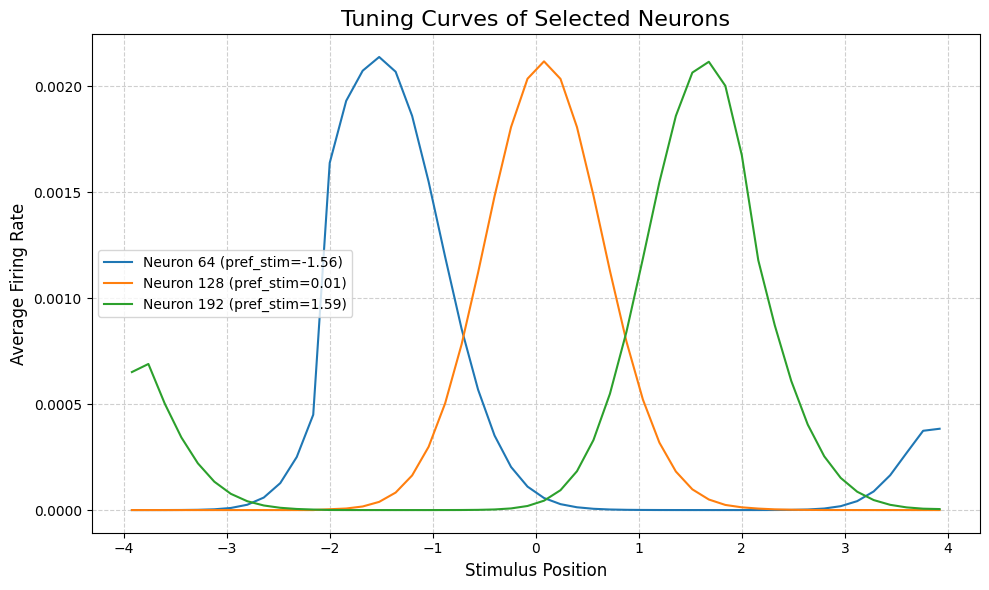

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Tuning Curves of Selected Neurons'}, xlabel='Stimulus Position', ylabel='Average Firing Rate'>)

In [30]:
# 配置调谐曲线config_tuning = PlotConfigs.tuning_curve(    num_bins=50,          # 位置分箱数    pref_stim=model.x,    # 每个神经元的优选刺激    title='Tuning Curves of Selected Neurons',    xlabel='Average Firing Rate',    ylabel='Average Firing Rate',    show=True,    save_path=None,)# 选择要绘制的神经元neuron_indices = [64, 128, 192]  # 左、中、右# 绘制调谐曲线tuning_curve(    stimulus=task.Iext_sequence.squeeze(),    firing_rates=r_history,    neuron_indices=neuron_indices,    config=config_tuning)

调谐曲线揭示了每个神经元的"偏好位置"——引发最大响应的刺激位置。对于CANN模型，神经元通常具有以不同位置为中心的钟形调谐曲线。

---

## 3. 不同任务的能量景观

不同的任务产生特征性的能量景观模式。让我们比较三个追踪任务：

### 3.1 PopulationCoding1D

群体编码展示了在短暂刺激呈现后的记忆维持。

In [ ]:
from canns.task.tracking import PopulationCoding1D# 重新初始化模型model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)model.init_state()# 群体编码任务task_pc = PopulationCoding1D(    cann_instance=model,    before_duration=10.0,    after_duration=10.0,    Iext=0.0,    duration=20.0,    time_step=brainstate.environ.get_dt(),)# 获取数据并运行仿真task_pc.get_data()u_pc, r_pc, inp_pc = brainstate.transform.for_loop(    run_step,    task_pc.run_steps,    task_pc.data,    pbar=brainstate.transform.ProgressBar(10))# 可视化config_anim = PlotConfigs.energy_landscape_1d_animation(    time_steps_per_second=100,  # 100个时间步 = 1秒真实时间    fps=20,                      # 每秒20帧    title='Energy Landscape Animation - Population Coding',    xlabel='Firing Rate',    ylabel='Firing Rate',    repeat=True,    show=True,    save_path=None  # 设置为 'animation.gif' 来保存)# 生成动画energy_landscape_1d_animation(    data_sets={'u': (model.x, u_pc), 'stimlulus': (model.x, inp_pc)},    config=config_anim)

<PopulationCoding1D>Generating Task data(No For Loop)


  0%|          | 0/400 [00:00<?, ?it/s]

**特征模式**：凸起在刺激呈现期间（中间部分）形成，并在刺激结束后保持在同一位置（右侧部分）。这演示了吸引子的稳定性和记忆维持能力。

### 3.2 TemplateMatching1D

模板匹配演示从噪声输入进行模式补全。

In [37]:
from canns.task.tracking import TemplateMatching1D# 重新初始化模型model.init_state()# 模板匹配任务task_tm = TemplateMatching1D(    cann_instance=model,    Iext=1.0,    duration=50.0,    time_step=brainstate.environ.get_dt(),)# 获取数据并运行模拟task_tm.get_data()u_tm, r_tm, inp_tm = brainstate.transform.for_loop(    run_step,    task_tm.run_steps,    task_tm.data,    pbar=brainstate.transform.ProgressBar(10))# 可视化config_anim = PlotConfigs.energy_landscape_1d_animation(    time_steps_per_second=100,  # 100个时间步 = 1秒真实时间    fps=20,                      # 每秒20帧    title='Energy Landscape Animation - Template Matching',    xlabel='Firing Rate',    ylabel='Firing Rate',    repeat=True,    show=True,    save_path=None  # 设置为 'animation.gif' 以保存)# 生成动画energy_landscape_1d_animation(    data_sets={'u': (model.x, u_tm), 'stimlulus': (model.x, inp_tm)},    config=config_anim)

<TemplateMatching1D>Generating Task data: 100%|██████████| 500/500 [00:00<00:00, 8404.61it/s]


  0%|          | 0/500 [00:00<?, ?it/s]

**特征模式**：初始分散的活动（噪声输入产生广泛、微弱的激活）收敛到单个尖锐的峰值。这展示了吸引子通过收敛来"清理"噪声输入的能力。

### 3.3 SmoothTracking1D

平滑跟踪演示了凹陷跟随移动刺激的情况。

In [38]:
from canns.task.tracking import SmoothTracking1D# 重新初始化模型model.init_state()# 平滑追踪任务task_st = SmoothTracking1D(    cann_instance=model,    Iext=[-2.0, 2.0],    duration=[50.0],    time_step=brainstate.environ.get_dt(),)# 获取数据并运行模拟task_st.get_data()u_st, r_st, inp_st = brainstate.transform.for_loop(    run_step,    task_st.run_steps,    task_st.data,    pbar=brainstate.transform.ProgressBar(10))# 可视化config_anim = PlotConfigs.energy_landscape_1d_animation(    time_steps_per_second=100,  # 100个时间步 = 1秒实时时间    fps=20,                      # 每秒20帧    title='Energy Landscape Animation - Smooth Tracking',    xlabel='Firing Rate',    ylabel='Firing Rate',    repeat=True,    show=True,    save_path=None  # 设置为'animation.gif'以保存)# 生成动画energy_landscape_1d_animation(    data_sets={'u': (model.x, u_st), 'stimlulus': (model.x, inp_st)},    config=config_anim)

<SmoothTracking1D> Generating Task data: 500it [00:00, 7279.28it/s]


  0%|          | 0/500 [00:00<?, ?it/s]

**特征模式**：凸起从左到右平稳移动，跟踪运动刺激。这展示了吸引子在整合外部输入的同时保持稳定凸起结构的能力。

### 3.4 对比总结

| 任务 | 输入模式 | 能量景观特征 | 演示 |
|------|--------------|--------------------------|--------------|
| PopulationCoding | 短暂刺激 | 凸起形成并原地保持 | 记忆维持 |
| TemplateMatching | 有噪声的连续输入 | 分布式活动 → 尖锐凸起 | 模式补全 |
| SmoothTracking | 运动刺激 | 凸起平稳跟踪轨迹 | 刺激跟踪 |

这三种模式说明了连续吸引子网络的三个关键计算能力：**记忆**、**去噪**和**跟踪**。

---

## 4. 2D分析方法

对于CANN2D模型，分析器提供相应的2D可视化方法。PlotConfigs模式对2D可视化的工作方式相同。

### 4.1 准备CANN2D仿真

In [39]:
from canns.models.basic import CANN2D
from canns.task.tracking import SmoothTracking2D
from canns.analyzer.plotting import (
    PlotConfigs,
    energy_landscape_2d_static,
    energy_landscape_2d_animation,
    plot_firing_field_heatmap,
)

# 创建2D模型
model_2d = CANN2D(
    length=32,      # 32x32神经元网格
    tau=1.0,
    k=8.1,
    a=0.3,
    A=10,
    J0=4.0,
)
model_2d.init_state()

# 创建2D跟踪任务
# 从(-1, -1)移动到(1, 1)再到(-1, 1)
task_2d = SmoothTracking2D(
    cann_instance=model_2d,
    Iext=[(-1.0, -1.0), (1.0, 1.0), (-1.0, 1.0)],
    duration=[30.0, 30.0],
    time_step=0.1,
)

# 获取数据并运行模拟
task_2d.get_data()

def run_step_2d(t, inp):
    model_2d.update(inp)
    return model_2d.u.value, model_2d.r.value

u_history_2d, r_history_2d = brainstate.transform.for_loop(
    run_step_2d,
    task_2d.run_steps,
    task_2d.data,
    pbar=brainstate.transform.ProgressBar(10)
)

<SmoothTracking2D> Generating Task data: 600it [00:00, 745.20it/s]


  0%|          | 0/600 [00:00<?, ?it/s]

### 4.2 能量景观 2D（静态）

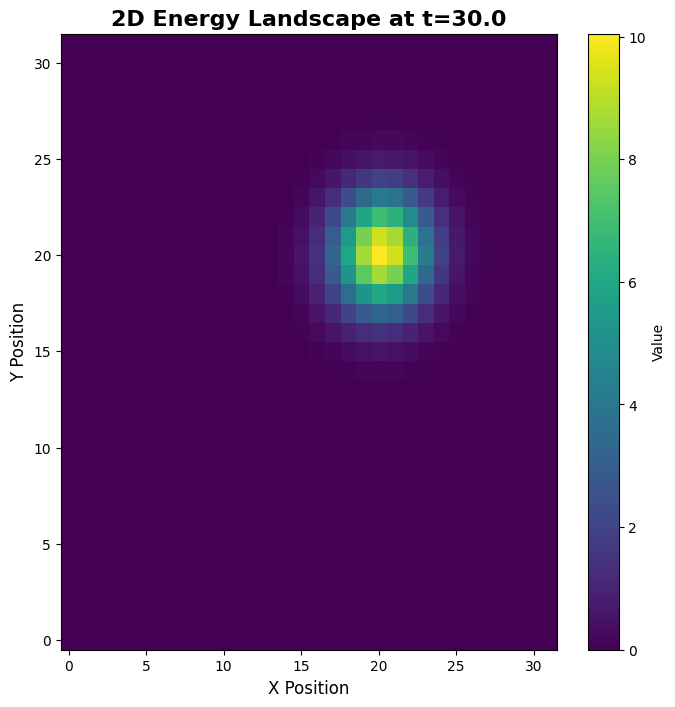

(<Figure size 800x800 with 2 Axes>,
 <Axes: title={'center': '2D Energy Landscape at t=30.0'}, xlabel='X Position', ylabel='Y Position'>)

In [42]:
# 选择一个时间点进行可视化time_idx = 300# 配置2D静态景观config_2d_static = PlotConfigs.energy_landscape_2d_static(    figsize=(8, 8),    title=f'2D能量景观 at t={time_idx * 0.1:.1f}',    xlabel='X Position',    ylabel='Y Position',    show=True,    save_path=None)# 绘制特定时间点的2D能量景观energy_landscape_2d_static(    z_data=u_history_2d[time_idx],    config=config_2d_static)

二维静态图显示了单个时间点的发放率空间分布，揭示了二维凸起结构。

### 4.3 能量景观二维（动画）

In [43]:
# 配置2D动画config_2d_anim = PlotConfigs.energy_landscape_2d_animation(    time_steps_per_second=100,    fps=20,    figsize=(8, 8),    title='2D Energy Landscape Animation',    xlabel='Y Position',    ylabel='Y Position',    repeat=True,    show=True,    save_path=None  # 设置为 'animation_2d.gif' 以保存)# 生成2D能量景观动画energy_landscape_2d_animation(    zs_data=u_history_2d,    config=config_2d_anim)

二维动画展示了凸起在二维特征空间中移动，遵循任务定义的轨迹。


---

## 5. 后续步骤

恭喜您完成教程3！您现在了解了：
- 如何使用PlotConfigs进行统一的可视化配置
- CANNs中所有主要的1D和2D可视化方法
- 不同任务如何产生特征性的能量景观模式
- 三个关键计算能力：记忆、去噪和跟踪

### 继续学习

- **下一步**: [教程4：参数效应](./04_parameter_effects.ipynb) - 探索参数如何系统地影响模型行为
- **高级应用**: 继续教程5-7了解分层模型和脑启发网络
- **实验数据**: 查看场景2：数据分析教程

### 关键要点

1. **PlotConfigs模式**: 始终使用 `PlotConfigs.method_name()` 创建配置，然后传递给绘图函数
2. **默认行为**: 绘图默认显示 (`show=True, save_path=None`)
3. **数据集**: 所有绘图函数接受 `data_sets` 字典以实现灵活的数据输入
4. **任务模式**: 不同任务揭示不同的吸引子属性（稳定性、收敛性、跟踪）